This file is use to parce the 16s rRNA barcode sequences stored on a Fasta file, keeping the species used on the analysis and saving each of them with their replicates on a specific file.

The sequences used on this file are from SILVA database (https://www.arb-silva.de/).

In [1]:
import os
import sys
import numpy as np
from Bio import SeqIO # To handle fasta files
import pickle
import random
import h5torch
import h5py

# Scheme
- Filter to known species
- Split the data set 
- Align the data set (Regular aligner Mafft)
- Align the data set (16s aligner SINA-Wasabi)
- Create a data module
- Evolutionary distance matrix
- Decoys

# Filter
For the species that are in the SILVA data base and the spectrum data

In [5]:
labelnames = list(np.load(os.path.join(sys.path[0],"Data/labelnames.npy")))
print("Total different species in the data set is",len(labelnames)) #Not much granularity
print("First instance as example\n",labelnames[0]) #Not much granularity

Total different species in the data set is 270
First instance as example
 Achromobacter xylosoxidans


In [24]:
#First create a data set with the species included in the Silva Data set
#Use SeqIO to iterate the descriptions (have the name) and look if they are on the labels

FullDataSet = [seq_record for seq_record in SeqIO.parse(os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_NR99_tax_silva_trunc.fasta"), "fasta")]
FilterData = [seq_record for seq_record in FullDataSet for specie in labelnames if specie in str(seq_record.description)]
#Faster but you can not count the lenght of the FullDataSet: ParcedData = [seq_record for n, seq_record in enumerate(SeqIO.parse(os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_NR99_tax_silva_trunc.fasta"), "fasta")) for specie in labelnames if specie in str(seq_record.description)]
savepath = os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(FilterData, output_handle, "fasta")

print(f"The original SILVA database has {len(FullDataSet)} samples")
print(f"The filtered data base has {len(FilterData)} samples")

#Note: The original data set has 510508 sequences and the parced has 42469
#Use grep -o 'bacteria_name' file.fasta | wc -l to count if there is no missed info

The original SILVA database has 510508 samples
The filtered data base has 42469 samples


# Split
Into train, test and val, recording the relevant metadata.

In [11]:
#Split
train = []
test = []
val = []
full = []
#MetaData
labels = []
splits = []
filos = []
species = []
#also counts
#Extra
random.seed(4) #Create in which split it belong
distribution = ["train"]*66 + ["test"]*17 + ["val"]*17
matcher = {}
counter = {}
c = 0
n = 0
for seq_record in SeqIO.parse(os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter.fasta"), "fasta"):
    if n == 0 : print(f"First instance as example:\n{seq_record}")
    desc = seq_record.description.split(" ")
    if len(desc) < 3: filo = seq_record.description #Some only have the filo on the description 
    else: filo = desc[1] + " " + desc[2] #not the id or extra info, just the filo
     #Correct for dots and brackets and unculture for sp and some known typos
    filo = filo.replace(".","").replace("[","").replace("]","")
    if "uncultured " in filo: filo = filo.replace("uncultured ","") + " sp"
    if "Haemophilus influenzae-murium" in filo : filo = filo.replace("-murium","")
    specie = filo.split(";")[-1]
    split = random.choice(distribution)

    if specie in labelnames: #Only save the ones that are on the data set, aparently they are all of them
        if specie not in species: #Create a new label id when a new specie appears
            matcher[specie] = c
            counter[specie] = 1
            filos.append(filo) 
            species.append(specie)
            split = "train" #if new add it to the data set
            c+=1
        splits.append(split) #Otherwise random choose an option
        labels.append(matcher[specie])
        counter[specie] += 1
        full.append(seq_record)
        if split == "train" : train.append(seq_record)
        if split == "test" : test.append(seq_record)
        if split == "val" : val.append(seq_record)
        n = 1
counts = [counter[specie] for specie in species]

First instance as example:
ID: AB004691.1.1449
Name: AB004691.1.1449
Description: AB004691.1.1449 Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Enterobacter;Pantoea agglomerans
Number of features: 0
Seq('ACGCUGGCGGCAGGCCUAACACAUGCAAGUCGAACGGUAGCACAGAGAGCUUGC...UGA')


In [12]:
#Summary of results
print(f"A total of {len(splits)} samples:")
print(f"Divided in {splits.count('train')} train, {splits.count('val')} validation and {splits.count('test')} test")
print(f"With additional {splits.count('new')} samples as instances of new data")
print(f"With a total of {len(set(filos))} diff species")
not_found = list(set(labelnames).difference(set(species)))
print("------------------------------------------------------------------")
print("The meta data format with first instance as example")
print(f"filos: {filos[0]}")
print(f"species: {species[0]}")
print(f"label: {labels[0]}")
print(f"And {len(not_found)} were not found")

A total of 42443 samples:
Divided in 28132 train, 7132 validation and 7179 test
With additional 0 samples as instances of new data
With a total of 224 diff species
------------------------------------------------------------------
The meta data format with first instance as example
filos: Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Enterobacter;Pantoea agglomerans
species: Pantoea agglomerans
label: 0
And 46 were not found


In [34]:
#Save the metadata in a h5 file and seqs as fastas
with h5torch.File('Data/SILVA_138.1_SSURef_Filter_metadata.h5', 'w') as h5file: #consider a h5t extent
    #For instances
    instancesdata = h5file.create_group("instances")
    instancesdata["label"] = labels
    instancesdata["split"] = splits
    #For species
    speciesdata = h5file.create_group("species")
    speciesdata["specie"] = species
    speciesdata["filo"] = filos
    speciesdata["count"] = counts


savepath = os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter_train.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(train, output_handle, "fasta")

savepath = os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter_test.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(test, output_handle, "fasta")

savepath = os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter_val.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(val, output_handle, "fasta")

savepath = os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter_full.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(full, output_handle, "fasta")

# Mafft align
Try to align all the train set

## All train data set

In [35]:
command = "mafft  --auto --inputorder Data/SILVA_138.1_SSURef_Filter_train.fasta > Data/SILVA_138.1_SSURef_Filter_train_align.fasta"
os.system(command)
#Is to long 18153

nthread = 0
nthreadpair = 0
nthreadtb = 0
ppenalty_ex = 0
stacksize: 8192 kb
generating a scoring matrix for nucleotide (dist=200) ... done
Gap Penalty = -1.53, +0.00, +0.00

very compact.


Making a distance matrix ..

There are 7318 ambiguous characters.
Compact tree, step 1
 28132 / 28132
done.
Constructing a tree ... 
done.

Progressive alignment 1/2... 
STEP   487 / 28131 
Reallocating..done. *alloclen = 4910
STEP  6701 / 28131  h
Reallocating..done. *alloclen = 6075
STEP  7101 / 28131 
Reallocating..done. *alloclen = 8326
STEP  11901 / 28131  h
Reallocating..done. *alloclen = 9664
STEP  14601 / 28131  h
Reallocating..done. *alloclen = 12662
STEP  17201 / 28131 
Reallocating..done. *alloclen = 13779
STEP  28001 / 28131  h
Reallocating..done. *alloclen = 23339
STEP  28101 / 28131 
done.

Making a compact tree from msa, step 1.. 
    0 / 281322
Constructing a tree ... 
done.

Progressive alignment 2/2... 
STEP  2101 / 28131  h
Reallocating..done. *alloclen = 4667
STEP  6901 / 28131 

0

## Get an general species consensus for train data set

In [3]:
#Get the meta info of the species
metadata = h5py.File("Data/SILVA_138.1_SSURef_Filter_metadata.h5", "r")

In [15]:
#get the species of the training set
train_spe = []
for i in range(len(metadata["instances/label"])):
    if metadata["instances/split"][i].decode('utf-8') == "train":
        train_spe.append(metadata["species/specie"][metadata["instances/label"][i]].decode('utf-8')) #Decode the str as is saved as binary

In [16]:
#Separate per species
subsets = {}
for i, seq_record in enumerate(SeqIO.parse(os.path.join(sys.path[0],"Data/SILVA_138.1_SSURef_Filter_train.fasta"), "fasta")):
    specie = train_spe[i] 
    if specie not in subsets: subsets[specie] = []
    subsets[specie].append(seq_record)

In [17]:
#Save the record for alignment
for specie in subsets:
    savepath = os.path.join(sys.path[0],f"Data/SILVA_138.1_SSURef_Filter_train_{specie}_subset.fasta")
    with open(savepath, "w") as output_handle:
        SeqIO.write(subsets[specie], output_handle, "fasta")

In [18]:
#Check the subsets, that are the ones to be aligned
path_in = os.path.join(sys.path[0],"Data/Aligns")
files_to_align = [file for file in os.listdir(path_in) if "_subset" in file]
print(f"{len(files_to_align)} files remain to align")

224 files remain to align


In [19]:
#Align them
for file in files_to_align:
    in_file = os.path.join(path_in,file)
    out_file = in_file.replace("_subset.fasta","_aligned.fasta").replace("SILVA_138.1_SSURef_Filter_","")
    command = f'mafft  --auto --inputorder "{in_file}" > "{out_file}"'
    os.system(command)
    os.remove(in_file) #Remove the subset

outputhat23=16
treein = 0
compacttree = 0
stacksize: 8192 kb
generating a scoring matrix for nucleotide (dist=200) ... done
All-to-all alignment.
tbfast-pair (nuc) Version 7.526
alg=L, model=DNA200 (2), 2.00 (6.00), -0.10 (-0.30), noshift, amax=0.0
0 thread(s)

outputhat23=16
Loading 'hat3.seed' ... 
done.
Writing hat3 for iterative refinement
generating a scoring matrix for nucleotide (dist=200) ... done
Gap Penalty = -1.53, +0.00, +0.00
tbutree = 1, compacttree = 0
Constructing a UPGMA tree ... 
    0 / 4
done.

Progressive alignment ... 
STEP     3 /3 
done.
tbfast (nuc) Version 7.526
alg=A, model=DNA200 (2), 1.53 (4.59), -0.00 (-0.00), noshift, amax=0.0
1 thread(s)

minimumweight = 0.000010
autosubalignment = 0.000000
nthread = 0
randomseed = 0
blosum 62 / kimura 200
poffset = 0
niter = 16
sueff_global = 0.100000
nadd = 16
Loading 'hat3' ... done.
generating a scoring matrix for nucleotide (dist=200) ... done

    0 / 4
Segment   1/  1    1-1502
STEP 003-003-1  identical.   
Conver

In [30]:
#Check the alings, that are the ones to cons
path_in = os.path.join(sys.path[0],"Data/Aligns")
path_out = os.path.join(sys.path[0],"Data/Consensus")
species_done = [file.replace("_cons.fasta","") for file in os.listdir(path_out) if "_cons.fasta" in file]
species_to_cons = [file.replace("_aligned.fasta","") for file in os.listdir(path_in) if "_aligned.fasta" in file and file.replace("_aligned.fasta","_cons.fasta") not in files_done]
print(f"{len(list(set(species_to_cons)-set(species_done)))} species remain to do consensus")


0 species remain to do consensus


In [29]:
#Check the alings, that are the ones to cons
from Bio import AlignIO # To handle the alignment files
from Bio.Align.AlignInfo import SummaryInfo # To do the consensus
from Bio.SeqRecord import SeqRecord # To edit the consensus files as one seq file
for specie in species_to_cons:
    in_file = os.path.join(path_in,f"{specie}_aligned.fasta")  
    out_file = os.path.join(path_out,f"{specie}_cons.fasta")  
    alignment = AlignIO.read(in_file, "fasta")
    consensus_seq = SummaryInfo(alignment).dumb_consensus()
    record = SeqRecord(consensus_seq, id=f"{specie}_consensus", description=f"Consensus of {len(alignment)} sequences of {specie.split('_')[-1]}")
    SeqIO.write(record, out_file, "fasta")



In [41]:
consensus_record = []
path_cons = os.path.join(sys.path[0],"Data/Consensus")
for file in os.listdir(path_cons):
    consensus_record += [len(seq_record.seq) for seq_record in SeqIO.parse(os.path.join(path_cons,file), "fasta")]

In [44]:
#Add all the consensus in a file and made the alignment that is then get a consensus
consensus_record = []
path_cons = os.path.join(sys.path[0],"Data/Consensus")
path_aligns = os.path.join(sys.path[0],"Data/Aligns")
for file in os.listdir(path_cons):
    consensus_record += [seq_record for seq_record in SeqIO.parse(os.path.join(path_cons,file), "fasta")]

#Store the desired seq data as a fasta
savepath = os.path.join(path_aligns,"train_Consensus.fasta") 
with open(savepath, "w") as output_handle:
    SeqIO.write(consensus_record, output_handle, "fasta")

In [46]:
#Check if the consensus have a good lenght
seq_len = 0
for seq_record in SeqIO.parse(os.path.join(path_aligns,"train_Consensus.fasta"), "fasta"):
    if len(seq_record.seq) >= seq_len :
        seq_len = len(seq_record.seq)
        longest_seq = seq_record.id  
print(f"The longest seq is {longest_seq} with a len of {seq_len}") 
#Important : Mafft aligns faster but Muscle have less gaps

The longest seq is train_Escherichia with a len of 4057


In [47]:
#Create the alignment
from Bio.Align.Applications import MuscleCommandline # Use for the species alignment
muscle_exe = os.path.join(sys.path[0],"muscle3.8.31_i86linux64") #Muscle is better as they are different species
in_file = os.path.join(sys.path[0],"Data/Aligns/train_Consensus.fasta")
out_file = os.path.join(sys.path[0],"Data/Aligns/train_Consensus_alignment.fasta")
muscle_cline = MuscleCommandline(muscle_exe, input=in_file, out=out_file)
print(muscle_cline)
muscle_cline() #chmod +x muscle3.8.31_i86linux64 to give permission to execute
if os.path.exists(in_file) : os.remove(in_file)

/home/jorge/thesis/muscle3.8.31_i86linux64 -in /home/jorge/thesis/Data/Aligns2/train_Consensus.fasta -out /home/jorge/thesis/Data/Aligns2/train_Consensus_alignment.fasta


In [49]:
#Do the dump consensus
in_file = os.path.join(sys.path[0],"Data/Aligns/train_Consensus_alignment.fasta")
out_file = os.path.join(sys.path[0],"Data/Consensus/train_General consensus.fasta")
alignment = AlignIO.read(in_file, "fasta")
consensus_seq = SummaryInfo(alignment).dumb_consensus()
record = SeqRecord(consensus_seq, id=f"General consensus", description=f"General consensus of {len(alignment)} different species")
SeqIO.write(record, out_file, "fasta")

1

In [5]:
#Do the add alignment to this train data
in_file = os.path.join(sys.path[0],"Data/Consensus/train_General consensus.fasta")
command = f'mafft  --add Data/SILVA_138.1_SSURef_Filter_full.fasta --keeplength --auto --inputorder "{in_file}" > Data/SILVA_138.1_SSURef_Filter_full_Add.fasta'
os.system(command) 

nadd = 42443
nthread = 0
nthreadpair = 0
nthreadtb = 0
ppenalty_ex = 0
stacksize: 8192 kb->8289 kb
generating a scoring matrix for nucleotide (dist=200) ... done
Gap Penalty = -1.53, +0.00, +0.00

very compact.


Making a distance matrix ..

There are 14089 ambiguous characters.
Compact tree, step 1
 42444 / 42444
done.
Constructing a tree ... 
done.

Progressive alignment 1/2... 
STEP  10701 / 42443  h
Reallocating..done. *alloclen = 9787
STEP  17301 / 42443  h
Reallocating..done. *alloclen = 10885
STEP  19501 / 42443 
Reallocating..done. *alloclen = 12565
STEP  22001 / 42443 
Reallocating..done. *alloclen = 15630
STEP  25801 / 42443 
Reallocating..done. *alloclen = 16661
STEP  42301 / 42443  h
Reallocating..done. *alloclen = 29050
STEP  42401 / 42443 
done.

Making a compact tree from msa, step 1.. 
    0 / 424444
Constructing a tree ... 
done.

Progressive alignment 2/2... 
STEP  16801 / 42443  h
Reallocating..done. *alloclen = 10386
STEP  19501 / 42443  h
Reallocating..done. *alloc

0

In [3]:
#Check if the final data set is correct
for i, seq_record in enumerate(SeqIO.parse("Data/SILVA_138.1_SSURef_Filter_full_Add.fasta", "fasta")):
    if i == 0 : print(f"The alignment has a lenght of {len(seq_record.seq)}, the first instance is the general consensus of the train set and should not be considered as instance for the model")
    print(i,seq_record.description)

The alignment has a lenght of 4202, the first instance is the general consensus of the train set and should not be considered as instance for the model
0 General consensus General consensus of 224 different species
1 AB004691.1.1449 Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Enterobacter;Pantoea agglomerans
2 AF527826.1.1479 Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Escherichia-Shigella;Escherichia coli
3 AB004750.1.1438 Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Klebsiella;Klebsiella aerogenes
4 AB006127.1.1290 Bacteria;Firmicutes;Bacilli;Lactobacillales;Streptococcaceae;Streptococcus;Streptococcus parasanguinis
5 KY622401.1.1298 Bacteria;Firmicutes;Bacilli;Bacillales;Bacillaceae;Bacillus;Bacillus cereus
6 KU218551.1.1231 Bacteria;Proteobacteria;Gammaproteobacteria;Enterobacterales;Enterobacteriaceae;Escherichia-Shigella;Escherichia coli
7 AB002524.1.1358 Bacteria;Firmicutes

## Store in a h5torch file
To create the data module

In [6]:
#Load the meta data
h5seqs = h5py.File("Data/SILVA_138.1_SSURef_Filter_metadata.h5", "r")
h5seqs.visititems(print)
#Most of the info is already on the metadata, split, label, species and filo
#Still need to do: ohe the labels, add the not aligned and aligned sequences, ohe the aligned sequences and add them, and add the descriptions

instances <HDF5 group "/instances" (2 members)>
instances/label <HDF5 dataset "label": shape (42443,), type "<i8">
instances/split <HDF5 dataset "split": shape (42443,), type "|O">
species <HDF5 group "/species" (3 members)>
species/count <HDF5 dataset "count": shape (224,), type "<i8">
species/filo <HDF5 dataset "filo": shape (224,), type "|O">
species/specie <HDF5 dataset "specie": shape (224,), type "|O">


In [67]:
#Ohe the labels
labels_ohe = []
m = len(h5seqs["species/specie"])
for label in h5seqs["instances/label"]:
    ohe = np.zeros(m)
    ohe[label] = 1
    labels_ohe.append(ohe)

In [56]:
#Get the not aligned sequences and the descriptions
not_aligned_seqs = []
descriptions = []
for seq_record in SeqIO.parse("Data/SILVA_138.1_SSURef_Filter_full.fasta", "fasta"):
    not_aligned_seqs.append(str(seq_record.seq)) #Converted to string for better compatibility with numpy and h5
    descriptions.append(str(seq_record.description))

In [32]:
#For seqs ohe
def SeqOneHotEncoder(sequence):
    """
    One hot encoder for DNA/RNA sequences
    A,a first col
    C,c second col
    G,g third col
    T,t/U,u fourth col
    Others fifth col
    """
    ohe_seq = []
    mapping = {"A": [1,0,0,0,0], "C": [0,1,0,0,0], "G": [0,0,1,0,0], "T": [0,0,0,1,0], "U": [0,0,0,1,0],
                "a": [1,0,0,0,0], "c": [0,1,0,0,0], "g": [0,0,1,0,0], "t": [0,0,0,1,0], "u": [0,0,0,1,0]}
    ohe_seq = []
    for i in sequence: #Maybe is ineficient
        ohe_seq.append(mapping[i] if i in mapping.keys() else [0,0,0,0,1])
    return  np.array(ohe_seq).T ##Use the transpose to change the OHE format, shape should be (c,l), where are channels and length, respectively"

In [62]:
#Get the aligned sequences and ohe it
import itertools
aligned_seqs = []
aligned_seqs_ohe = []
for seq_record in itertools.islice(SeqIO.parse("Data/SILVA_138.1_SSURef_Filter_full_Add.fasta", "fasta"),1,None): #The first element is the consensus and need to be skiped
    aligned_seqs.append(str(seq_record.seq))
    aligned_seqs_ohe.append(SeqOneHotEncoder(seq_record.seq))

In [69]:
#create the h5torch with all the data (https://h5torch.readthedocs.io/en/latest/tutorial.html)
with h5torch.File('Data/cnn_seqs.h5t', 'w') as h5tfile:
    h5tfile.register(np.array(labels_ohe), axis = "central") #The list needs to be transformed to numpy
    h5tfile.register(h5seqs["instances/split"], axis = 0, name="split") #Data alreayd saved on h5 files do not need further modifications
    h5tfile.register(np.array(not_aligned_seqs), axis = 0, name="seq", dtype_save="bytes") #String need to be saved as bits
    h5tfile.register(np.array(aligned_seqs), axis = 0, name="seq_aligned", dtype_save="bytes") #String need to be saved as bits
    h5tfile.register(np.array(aligned_seqs_ohe), axis = 0, name="seq_aligned_ohe") #The list needs to be transformed to numpy
    h5tfile.register(h5seqs["species/specie"], axis = 1, name="species") #Data alreayd saved on h5 files do not need further modifications
    h5tfile.register(h5seqs["species/filo"], axis = 1, name="species_filo") #Data alreayd saved on h5 files do not need further modifications
    h5tfile.register(np.array(descriptions), axis = "unstructured", name="description", dtype_save="bytes") #String need to be saved as bits

In [71]:
h5tseqs = h5py.File("Data/cnn_seqs.h5t", "r") # The old version has problems on the split
h5tseqs.visititems(print)


0 <HDF5 group "/0" (4 members)>
0/seq <HDF5 dataset "seq": shape (42443,), type "|S1820">
0/seq_aligned <HDF5 dataset "seq_aligned": shape (42443,), type "|S4202">
0/seq_aligned_ohe <HDF5 dataset "seq_aligned_ohe": shape (42443, 5, 4202), type "<i8">
0/split <HDF5 dataset "split": shape (42443,), type "|O">
1 <HDF5 group "/1" (2 members)>
1/species <HDF5 dataset "species": shape (224,), type "|O">
1/species_filo <HDF5 dataset "species_filo": shape (224,), type "|O">
central <HDF5 dataset "central": shape (42443, 224), type "<f8">
unstructured <HDF5 group "/unstructured" (1 members)>
unstructured/description <HDF5 dataset "description": shape (42443,), type "|S191">


Now the data can be loaded into a data module to be used for training the model

## Add the ohe to the previous data

In [12]:
import torch
with h5torch.File('Data/zsl_binned_new.h5t', 'a') as h5tfile:
    seqs = h5tfile["1"]["strain_seq_aligned"]
    dim2 = []
    for inst in seqs:
        dim1 = []
        for pos in inst:
            dim0=[0,0,0,0,0,0]
            dim0[pos] = 1
            dim1.append(dim0)
        dim2.append(dim1)
    oheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions
    print(oheseqs.shape)
    h5tfile.register(oheseqs.numpy(), axis = 1, name="strain_seq_aligned_ohe", dtype_save = "bool", dtype_load = "int64") #The list needs to be transformed to numpy

torch.Size([788, 6, 2236])


In [13]:
h5tseqs = h5py.File("Data/zsl_binned_new.h5t", "r") # The old version has problems on the split
h5tseqs.visititems(print)

0 <HDF5 group "/0" (11 members)>
0/intensity <HDF5 dataset "intensity": shape (29105, 6000), type "<f4">
0/split_0 <HDF5 dataset "split_0": shape (29105,), type "|S11">
0/split_1 <HDF5 dataset "split_1": shape (29105,), type "|S11">
0/split_2 <HDF5 dataset "split_2": shape (29105,), type "|S11">
0/split_3 <HDF5 dataset "split_3": shape (29105,), type "|S11">
0/split_4 <HDF5 dataset "split_4": shape (29105,), type "|S11">
0/split_5 <HDF5 dataset "split_5": shape (29105,), type "|S11">
0/split_6 <HDF5 dataset "split_6": shape (29105,), type "|S11">
0/split_7 <HDF5 dataset "split_7": shape (29105,), type "|S11">
0/split_8 <HDF5 dataset "split_8": shape (29105,), type "|S11">
0/split_9 <HDF5 dataset "split_9": shape (29105,), type "|S11">
1 <HDF5 group "/1" (4 members)>
1/strain_names <HDF5 dataset "strain_names": shape (788,), type "|S124">
1/strain_seq <HDF5 dataset "strain_seq": shape (788,), type "|S1676">
1/strain_seq_aligned <HDF5 dataset "strain_seq_aligned": shape (788, 2236), type

# SINA align

In [2]:
h5tseqs = h5py.File("Data/zsl_binned_new.h5t", "r") # The old version has problems on the split

In [3]:
import numpy as np
train = set()
validation = set()
test = set()
complete = set()
for i, split in enumerate(h5tseqs["0/split_0"]):
    complete.add(h5tseqs["1/strain_names"][np.argmax(h5tseqs["central"][i])])
    if split == b'train': train.add(h5tseqs["1/strain_names"][np.argmax(h5tseqs["central"][i])])
    elif b'val' in split : validation.add(h5tseqs["1/strain_names"][np.argmax(h5tseqs["central"][i])])
    else: test.add(h5tseqs["1/strain_names"][np.argmax(h5tseqs["central"][i])])

In [4]:
#here to loop, use the final to get which sequences are on train and val, the rest go to test
#use it to create the respective fasta data sets.
from Bio import SeqIO # 
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
train_recs = []
val_recs = []
test_recs = []
complete_recs = []
matchesns = {}
with h5torch.File('Data/zsl_raw.h5t', 'r') as h5tfile:
    for i, name in enumerate(h5tfile["1/strain_names"]):
        record = SeqRecord(
             Seq(h5tfile["1/strain_seq"][i]),
            id= name.decode('utf-8').replace(" ","_"),
            name= name.decode('utf-8'),
            description=name.decode('utf-8'),
        )
        if name in train: train_recs.append(record)
        elif name in validation: val_recs.append(record)
        else: test_recs.append(record)
        complete_recs.append(record)
        matchesns[name.decode('utf-8')] = f'seq_{i}'

In [5]:
savepath = "Data/train_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(train_recs, output_handle, "fasta")
savepath = "Data/val_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(val_recs, output_handle, "fasta")
savepath = "Data/test_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(test_recs, output_handle, "fasta")
savepath = "Data/full_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(complete_recs, output_handle, "fasta")

In [ ]:
#Create trainwithroot_SILVA.fasta with the out group
#Align them
#Add the others sets
#Add them to the data set by comparing the name with "1/strain_name"
#Use mega to get the distance matrix and trees

In [7]:
trainex_recs= train_recs
for record in SeqIO.parse(os.path.join(sys.path[0],"arb-silva.de_2024-08-04_id1341285_tax_silva_trunc.fasta"), "fasta"):
    trainex_recs.append(record)

savepath = "Data/trainwithroot_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(trainex_recs, output_handle, "fasta")

In [8]:
completeex_recs = complete_recs
for record in SeqIO.parse(os.path.join(sys.path[0],"arb-silva.de_2024-08-04_id1341285_tax_silva_trunc.fasta"), "fasta"):
    completeex_recs.append(record)

savepath = "Data/fullwithroot_SILVA.fasta"
with open(savepath, "w") as output_handle:
    SeqIO.write(completeex_recs, output_handle, "fasta")

## Create new data set

In [3]:
h5spectra = h5py.File("Data/zsl_binned_new.h5t", "r")
h5spectra.visititems(print)

0 <HDF5 group "/0" (11 members)>
0/intensity <HDF5 dataset "intensity": shape (29105, 6000), type "<f4">
0/split_0 <HDF5 dataset "split_0": shape (29105,), type "|S11">
0/split_1 <HDF5 dataset "split_1": shape (29105,), type "|S11">
0/split_2 <HDF5 dataset "split_2": shape (29105,), type "|S11">
0/split_3 <HDF5 dataset "split_3": shape (29105,), type "|S11">
0/split_4 <HDF5 dataset "split_4": shape (29105,), type "|S11">
0/split_5 <HDF5 dataset "split_5": shape (29105,), type "|S11">
0/split_6 <HDF5 dataset "split_6": shape (29105,), type "|S11">
0/split_7 <HDF5 dataset "split_7": shape (29105,), type "|S11">
0/split_8 <HDF5 dataset "split_8": shape (29105,), type "|S11">
0/split_9 <HDF5 dataset "split_9": shape (29105,), type "|S11">
1 <HDF5 group "/1" (4 members)>
1/strain_names <HDF5 dataset "strain_names": shape (788,), type "|S124">
1/strain_seq <HDF5 dataset "strain_seq": shape (788,), type "|S1676">
1/strain_seq_aligned <HDF5 dataset "strain_seq_aligned": shape (788, 2236), type

### Prepare data

In [4]:
order = []
for i, name in enumerate(h5spectra["1/strain_names"]):
    order.append(name.decode('utf-8'))

In [6]:
matchessa = {}
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_val.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_test.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record

In [14]:
seqorder = []
for name in order:
    seqorder.append(matchessa[matchesns[name]])

In [10]:
nucleotide_mapping = {"-" : 0, "a" : 1, "u": 2, "c" : 3, "g" : 4, "other" : 5}
sequences_encoded = []
for a in seqorder:
    seq = str(a.seq)
    seq_encoded = np.array([(nucleotide_mapping[s] if s in nucleotide_mapping else 5) for s in seq], dtype="int8")
    sequences_encoded.append(seq_encoded) #Use this to replace the seq

In [12]:
#Copy from the original data set, central, 1/strain_names, 1/strain_seq, 0/intensity,  unstructured/mz
#sequences_encoded is 1/strain_seq_aligned, use it also to create 1/strain_seq_aligned_ohe
#from 0/split_0 create a set that is val_train (first do a distribution of the data sets instances)
split = list(h5spectra['0/split_0'])
splitex = list(h5spectra['0/split_0'])
print(split.count(b"train")) #consider 10% for val_train
print(split.count(b"val_geni"))
print(split.count(b"val_spec"))
print(split.count(b"val_strain"))

16854
3069
2323
549


In [13]:
import random
random.seed(4)
for i, x in enumerate(split):
    if x == b"train":
        if random.random() < 0.05: 
            split[i] = b'val_seen'
            splitex[i] = b'omit'
        if random.random() > 0.95:
            split[i] = b'test_seen'
            splitex[i] = b'omit'

print(split.count(b"train")) 
print(split.count(b"val_geni"))
print(split.count(b"val_spec"))
print(split.count(b"val_strain"))
print(split.count(b"val_seen")) #consider 10% for val_seen

15241
3069
2323
549
780


In [17]:
import torch
dim2 = []
for inst in sequences_encoded:
    dim1 = []
    for pos in inst:
        dim0=[0,0,0,0,0,0]
        dim0[pos] = 1
        dim1.append(dim0)
    dim2.append(dim1)
oheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions

In [18]:
oheseqs.shape

torch.Size([788, 6, 1816])

### Save data

In [19]:
with h5torch.File('Data/zsl_mafft.h5t', 'w') as h5tfile:
    h5tfile.register(h5spectra['central'], axis = "central") #The list needs to be transformed to numpy
    h5tfile.register(h5spectra['0/intensity'], axis = 0, name="intensity")
    h5tfile.register(np.array(list(h5spectra['0/split_0'])), axis = 0, name="split_0", mode="N-D", dtype_save="bytes", dtype_load="str") 
    h5tfile.register(np.array(split), axis = 0, name="split_1", mode="N-D", dtype_save="bytes", dtype_load="str") #The list needs to be transformed to numpy string need to be saved as bits
    h5tfile.register(np.array(splitex), axis = 0, name="split_2", mode="N-D", dtype_save="bytes", dtype_load="str") #The list needs to be transformed to numpy string need to be saved as bits
    h5tfile.register(h5spectra['1/strain_names'], axis = 1, name="strain_names")
    h5tfile.register(h5spectra['1/strain_seq'], axis = 1, name="strain_seq") 
    h5tfile.register(np.array(sequences_encoded), axis = 1, name = "strain_seq_aligned", mode = "N-D", dtype_save="int8", dtype_load="int64") 
    h5tfile.register(oheseqs.numpy(), axis = 1, name="strain_seq_aligned_ohe", dtype_save = "bool", dtype_load = "int64") 
    h5tfile.register(h5spectra['unstructured/mz'], axis = "unstructured", name="mz")

In [21]:
info = {}
with h5torch.File('Data/zsl_mafft.h5t', 'r') as h5tfile:
    for i, split in enumerate(h5tfile['0/split_0']):
        if split in info: info[split].add(np.argmax(h5tfile['central'][i]))
        else: info[split] = set([np.argmax(h5tfile['central'][i])])

for key in info:
    print(key, len(info[key]))


b'train' 463
b'test_geni' 86
b'val_spec' 61
b'test_spec' 62
b'val_strain' 14
b'val_geni' 85
b'test_strain' 17


In [97]:
info = {}
with h5torch.File('Data/zsl_mafft.h5t', 'r') as h5tfile:
    for i, split in enumerate(h5tfile['0/split_1']):
        if split in info: info[split].add(np.argmax(h5tfile['central'][i]))
        else: info[split] = set([np.argmax(h5tfile['central'][i])])

for key in info:
    print(key, len(info[key]))

b'train' 463
b'val_seen' 380
b'test_geni' 86
b'val_spec' 61
b'test_spec' 62
b'test_seen' 379
b'val_strain' 14
b'val_geni' 85
b'test_strain' 17


In [22]:
info = {}
with h5torch.File('Data/zsl_mafft.h5t', 'r') as h5tfile:
    for i, split in enumerate(h5tfile['0/split_2']):
        if split in info: info[split].add(np.argmax(h5tfile['central'][i]))
        else: info[split] = set([np.argmax(h5tfile['central'][i])])

for key in info:
    print(key, len(info[key]))

b'train' 463
b'omit' 448
b'test_geni' 86
b'val_spec' 61
b'test_spec' 62
b'val_strain' 14
b'val_geni' 85
b'test_strain' 17


# Evo dist

In [3]:
#Load the full data set for the order of names
h5spectra = h5py.File("Data/zsl_binned_new.h5t", "r")
h5spectra.visititems(print)

0 <HDF5 group "/0" (11 members)>
0/intensity <HDF5 dataset "intensity": shape (29105, 6000), type "<f4">
0/split_0 <HDF5 dataset "split_0": shape (29105,), type "|S11">
0/split_1 <HDF5 dataset "split_1": shape (29105,), type "|S11">
0/split_2 <HDF5 dataset "split_2": shape (29105,), type "|S11">
0/split_3 <HDF5 dataset "split_3": shape (29105,), type "|S11">
0/split_4 <HDF5 dataset "split_4": shape (29105,), type "|S11">
0/split_5 <HDF5 dataset "split_5": shape (29105,), type "|S11">
0/split_6 <HDF5 dataset "split_6": shape (29105,), type "|S11">
0/split_7 <HDF5 dataset "split_7": shape (29105,), type "|S11">
0/split_8 <HDF5 dataset "split_8": shape (29105,), type "|S11">
0/split_9 <HDF5 dataset "split_9": shape (29105,), type "|S11">
1 <HDF5 group "/1" (4 members)>
1/strain_names <HDF5 dataset "strain_names": shape (788,), type "|S124">
1/strain_seq <HDF5 dataset "strain_seq": shape (788,), type "|S1676">
1/strain_seq_aligned <HDF5 dataset "strain_seq_aligned": shape (788, 2236), type

In [4]:
orderi = [np.argmax(i) for i in h5spectra['central']] #Use this as a guide for the vectors

In [5]:
#Unite the data sets
matchessa = {}
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_val.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_test.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record

In [11]:
aligns = []

#From a full
#for record in SeqIO.parse("Data/final/SINA/fullroot_SINA/arb-silva.de_2024-08-04_id1341286.fasta", "fasta"): #already in order
#    aligns.append(record)

#From splits
for id in h5spectra["1/strain_names"]:
    id = id.decode('utf-8').replace(" ","_")
    aligns.append(matchessa[id])
aligns.append(matchessa["AF053399.1.1400"])

In [12]:
savepath = os.path.join(sys.path[0],"Data/zsl_rootSINAwasabi.fasta")
with open(savepath, "w") as output_handle:
    SeqIO.write(aligns, output_handle, "fasta")

In [13]:
from Bio import AlignIO, Phylo
from Bio.Phylo.TreeConstruction import DistanceCalculator, DistanceTreeConstructor
from Bio.Align import MultipleSeqAlignment
import matplotlib.pyplot as plt

alignment = AlignIO.read("Data/zsl_rootSINAwasabi.fasta", "fasta")
calculator = DistanceCalculator('identity')
dist_matrix = calculator.get_distance(alignment) #Model: Jukes-Cantor

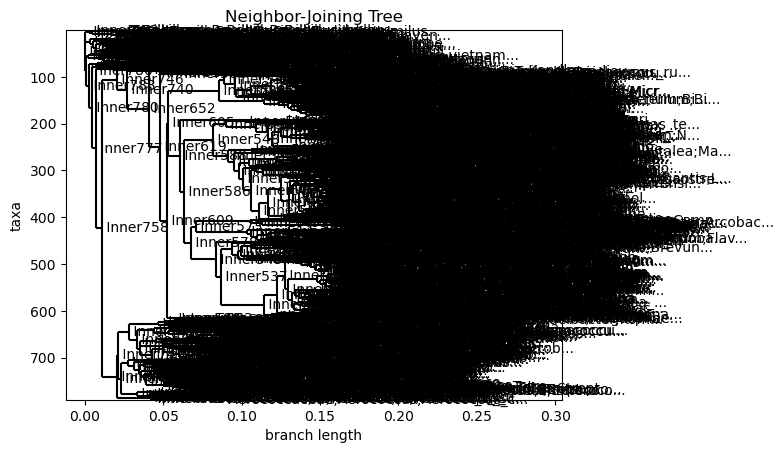

1

In [14]:
# Tree with Neighbor-Joining
constructor = DistanceTreeConstructor()
nj_tree = constructor.nj(dist_matrix)
# upgma_tree = constructor.upgma(dist_matrix) #UPGMA optional

# Tree visualization
Phylo.draw(nj_tree, do_show=False)
plt.title("Neighbor-Joining Tree")
plt.show()

# Save tree in Newick format
Phylo.write(nj_tree, "Data/nj_tree.newick", "newick")

In [15]:
central = []
#for i in orderi: #Use it to get the order for the central object of the h5torch
#    central.append(dist_matrix[int(i)])

central = list(dist_matrix)

In [28]:
suspect = 0
suspects = {}

for i, row in enumerate(central):
    if row.count(0) != 1: 
        print(row)
        suspect +=1
        suspects[h5spectra["1/strain_names"][i].decode('utf-8')] = [h5spectra["1/strain_names"][j].decode('utf-8') for j, value in enumerate(row) if value == 0]
print(suspect)    

[0, 0.0015120967741935054, 0.0, 0.0015120967741935054, 0.0015120967741935054, 0.019657258064516125, 0.02116935483870963, 0.04889112903225812, 0.020161290322580627, 0.04989919354838712, 0.011592741935483875, 0.011592741935483875, 0.012096774193548376, 0.05947580645161288, 0.05796370967741937, 0.05796370967741937, 0.055947580645161255, 0.04435483870967738, 0.07409274193548387, 0.06048387096774188, 0.029737903225806495, 0.0786290322580645, 0.01008064516129037, 0.05997983870967738, 0.016129032258064502, 0.06754032258064513, 0.028225806451612878, 0.05796370967741937, 0.08366935483870963, 0.07006048387096775, 0.07157258064516125, 0.08114919354838712, 0.040322580645161255, 0.05544354838709675, 0.02066532258064513, 0.09173387096774188, 0.045866935483870996, 0.03830645161290325, 0.058971774193548376, 0.05997983870967738, 0.046875, 0.06502016129032262, 0.09072580645161288, 0.06451612903225812, 0.06502016129032262, 0.06754032258064513, 0.05997983870967738, 0.053427419354838745, 0.0685483870967742

In [29]:
for id in suspects:
    print(id)

Acetobacteraceae;Acetobacter;Acetobacter aceti;LMG 1261
Acetobacteraceae;Acetobacter;Acetobacter aceti;LMG 1496
Acetobacteraceae;Acetobacter;Acetobacter aceti;LMG 1504
Acetobacteraceae;Acetobacter;Acetobacter aceti;LMG 1512
Acetobacteraceae;Acetobacter;Acetobacter estunensis;LMG 1572
Acetobacteraceae;Acetobacter;Acetobacter estunensis;LMG 1580
Acetobacteraceae;Acidomonas;Acidomonas methanolica;LMG 1667
Acetobacteraceae;Acidomonas;Acidomonas methanolica;LMG 1735
Acetobacteraceae;Asaia;Asaia bogorensis;LMG 23142
Acetobacteraceae;Asaia;Asaia bogorensis;LMG 23143
Acetobacteraceae;Gluconacetobacter;Gluconacetobacter liquefaciens;LMG 1381
Acetobacteraceae;Gluconacetobacter;Gluconacetobacter liquefaciens;LMG 1382
Acetobacteraceae;Gluconobacter;Gluconobacter albidus;LMG 1356
Acetobacteraceae;Gluconobacter;Gluconobacter albidus;LMG 1375
Acetobacteraceae;Gluconobacter;Gluconobacter cerinus;LMG 1361
Acetobacteraceae;Gluconobacter;Gluconobacter cerinus;LMG 1368
Acetobacteraceae;Gluconobacter;Gluco

In [31]:
suspects["Acetobacteraceae;Gluconobacter;Gluconobacter roseus;LMG 1418"]

['Acetobacteraceae;Gluconobacter;Gluconobacter oxydans;LMG 1359',
 'Acetobacteraceae;Gluconobacter;Gluconobacter oxydans;LMG 1393',
 'Acetobacteraceae;Gluconobacter;Gluconobacter roseus;LMG 1418']

In [33]:
for id in suspects["Acetobacteraceae;Gluconobacter;Gluconobacter roseus;LMG 1418"]:
    print(matchessa[id.replace(" ","_")].seq) #Infact the alignment of the three species is the same

---------------------------a-gcgaac-gcuggcggca-ugcuu-aac-acaug-caa-gu-cgc-acga---a----------------------------------g-----g---uuucg--------gc-----c-u-u-----------------------------------------agug-gc-ggacgggugaguaacgcguaggg-au-cuauccacgggu-gggggacaacuucgggaaacuggagcuaauaccgcaugau---------------acc-------------------u-ga-g---------gg--u-------------------caaa--g----------------g-c-------gca-ag--u--c-gc--cugug-g-aggaaccugcgu-ucgauuagcuaguuggug-ggguaaaggccuaccaagg-cgaugaucgauagcugguuugagaggaugaucagccacacugggacuga-gacacggccc-agacuccuac-gggaggca-gcagug-gggaauauuggacaaugggcga-a-agccugauccagcaaugccgcgugugugaagaagguc-uucggauuguaaagcacuuuc-ga-cggg--gac-g---a-----------------------u--ga---------------------u-gacg-guaccc-guagaagaagcc-ccggcuaacuucgugccagc-agccgcggua-au-acgaagggggcuagcguugcucgg-aaugacugggcguaaagg-gcgcguaggcgguugu-ua-cagucagaugugaaa-uccc-cgggcuuaacc-ugg-g-aacug-cauuugaua-cgugacgacuagaguucga-gagaggguugugg-aauucccagu-guag-ag-gug-aaa-uucguagauauu-gggaa-gaacaccggu--g-gc-gaa-ggcggcaac-cu

In [37]:
compare = []
for i, id in enumerate(h5spectra["1/strain_names"]):
    if id.decode('utf-8') in suspects["Acetobacteraceae;Gluconobacter;Gluconobacter roseus;LMG 1418"]:
        compare.append(h5spectra["1/strain_seq"][i].decode('utf-8'))
        print(h5spectra["1/strain_seq"][i].decode('utf-8'))


AGCGAACGCUGGCGGCAUGCUUAACACAUGCAAGUCGCACGAAGGUUUCGGCCUUAGUGGCGGACGGGUGAGUAACGCGUAGGGAUCUAUCCACGGGUGGGGGACAACUUCGGGAAACUGGAGCUAAUACCGCAUGAUACCUGAGGGUCAAAGGCGCAAGUCGCCUGUGGAGGAACCUGCGUUCGAUUAGCUAGUUGGUGGGGUAAAGGCCUACCAAGGCGAUGAUCGAUAGCUGGUUUGAGAGGAUGAUCAGCCACACUGGGACUGAGACACGGCCCAGACUCCUACGGGAGGCAGCAGUGGGGAAUAUUGGACAAUGGGCGAAAGCCUGAUCCAGCAAUGCCGCGUGUGUGAAGAAGGUCUUCGGAUUGUAAAGCACUUUCGACGGGGACGAUGAUGACGGUACCCGUAGAAGAAGCCCCGGCUAACUUCGUGCCAGCAGCCGCGGUAAUACGAAGGGGGCUAGCGUUGCUCGGAAUGACUGGGCGUAAAGGGCGCGUAGGCGGUUGUUACAGUCAGAUGUGAAAUCCCCGGGCUUAACCUGGGAACUGCAUUUGAUACGUGACGACUAGAGUUCGAGAGAGGGUUGUGGAAUUCCCAGUGUAGAGGUGAAAUUCGUAGAUAUUGGGAAGAACACCGGUGGCGAAGGCGGCAACCUGGCUCGAUACUGACGCUGAGGCGCGAAAGCGUGGGGAGCAAACAGGAUUAGAUACCCUGGUAGUCCACGCUGUAAACGAUGUGUGCUGGAUGUUGGGAAACUUAGUUUCUCAGUGUCGAAGCUAACGCGCUAAGCACACCGCCUGGGGAGUACGGCCGCAAGGUUGAAACUCAAAGGAAUUGACGGGGGCCCGCACAAGCGGUGGAGCAUGUGGUUUAAUUCGAAGCAACGCGCAGAACCUUACCAGGGCUUGCAUGGGGAGGACCGGUUCAGAGAUGGACCUUUCUUCGGACCUCCCGCACAGGUGCUGCAUGGCUGUCGUCAGCUCGUGUCGUGAGAUGU

In [40]:
for i, seq in enumerate(compare):
    try: print(seq == compare[i+1])
    except: print("end")
#In this cases all the sequences are the same

True
True
end


In [18]:
central[-1]#the outgroup is at last

[0.19606854838709675,
 0.19657258064516125,
 0.19606854838709675,
 0.19657258064516125,
 0.19657258064516125,
 0.19858870967741937,
 0.20010080645161288,
 0.18296370967741937,
 0.19909274193548387,
 0.18044354838709675,
 0.19556451612903225,
 0.19556451612903225,
 0.19606854838709675,
 0.17993951612903225,
 0.18094758064516125,
 0.19405241935483875,
 0.19254032258064513,
 0.18044354838709675,
 0.19455645161290325,
 0.17943548387096775,
 0.19758064516129037,
 0.20917338709677424,
 0.19707661290322576,
 0.17842741935483875,
 0.19506048387096775,
 0.18245967741935487,
 0.19556451612903225,
 0.17641129032258063,
 0.2016129032258065,
 0.19002016129032262,
 0.19002016129032262,
 0.204133064516129,
 0.20110887096774188,
 0.17943548387096775,
 0.19506048387096775,
 0.2026209677419355,
 0.19506048387096775,
 0.20060483870967738,
 0.17893145161290325,
 0.19506048387096775,
 0.18094758064516125,
 0.17842741935483875,
 0.20766129032258063,
 0.17792338709677424,
 0.17842741935483875,
 0.18094758064

In [48]:
order = []
for i, name in enumerate(h5spectra["1/strain_names"]):
    order.append(name.decode('utf-8'))

In [41]:
matchessa = {}
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_val.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record
for seq_record in SeqIO.parse(os.path.join("Data/trainroot_SINAwasabi_test.fasta"), "fasta"):
    matchessa[seq_record.id] = seq_record

In [54]:
seqorder = []
for name in order:
    key = name.replace(" ","_")
    seqorder.append(matchessa[key])
seqorder.append(matchessa["AF053399.1.1400"]) #"AF053399.1.1400" = Prochlorococcus_marinus_str._MIT_9313 is the outgroup

In [55]:
nucleotide_mapping = {"-" : 0, "a" : 1, "u": 2, "c" : 3, "g" : 4, "other" : 5}
sequences_encoded = []
for a in seqorder:
    seq = str(a.seq)
    seq_encoded = np.array([(nucleotide_mapping[s] if s in nucleotide_mapping else 5) for s in seq], dtype="int8")
    sequences_encoded.append(seq_encoded) #Use this to replace the seq

In [56]:
import torch
dim2 = []
for inst in sequences_encoded:
    dim1 = []
    for pos in inst:
        dim0=[0,0,0,0,0,0]
        dim0[pos] = 1
        dim1.append(dim0)
    dim2.append(dim1)
oheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions

In [57]:
oheseqs.shape

torch.Size([789, 6, 1984])

### Create the h5

In [73]:
#Prepare the modifications
h5spectra = h5py.File("Data/final/zsl_mafft.h5t", "r") #load reference
fcentral = np.array(central)
fstrain_names = list(h5spectra['1/strain_names'])
fstrain_names.append("Prochlorococcus_marinus_str._MIT_9313")
fstrain_seq = list(h5spectra['1/strain_seq'])
for record in SeqIO.parse(os.path.join(sys.path[0],"arb-silva.de_2024-08-04_id1341285_tax_silva_trunc.fasta"), "fasta"):
    fstrain_seq.append(str(record.seq))

In [84]:
suspects = 0
for row in central:
    if row.count(0) != 1: 
        print(row)
        suspects +=1
print(suspects) #Some row have two zeros, check for this, consider the add alignment if needed

[0.008299999999999974, 0.008319999999999994, 0.008299999999999974, 0.008360000000000034, 0.008319999999999994, 0.008380000000000054, 0.008419999999999983, 0.007380000000000053, 0.008260000000000045, 0.007460000000000022, 0.008380000000000054, 0.008380000000000054, 0.008399999999999963, 0.007719999999999949, 0.00770000000000004, 0.008099999999999996, 0.007979999999999987, 0.007480000000000042, 0.008159999999999945, 0.007499999999999951, 0.008360000000000034, 0.008700000000000041, 0.008260000000000045, 0.00763999999999998, 0.008319999999999994, 0.00782000000000005, 0.008399999999999963, 0.007560000000000011, 0.00871999999999995, 0.008079999999999976, 0.008020000000000027, 0.009020000000000028, 0.008460000000000023, 0.007499999999999951, 0.008460000000000023, 0.008660000000000001, 0.007979999999999987, 0.008480000000000043, 0.007460000000000022, 0.008020000000000027, 0.007440000000000002, 0.007900000000000018, 0.008660000000000001, 0.007859999999999978, 0.007900000000000018, 0.00761999999

In [74]:
with h5torch.File('Data/zsl_SINA.h5t', 'w') as h5tfile:
    h5tfile.register(fcentral, axis = "central", mode = "N-D", dtype_save="int64", dtype_load="int64") 
    h5tfile.register(h5spectra['0/intensity'], axis = 0, name="intensity")
    h5tfile.register(h5spectra['0/split_0'], axis = 0, name="split_0") 
    h5tfile.register(h5spectra['0/split_1'], axis = 0, name="split_1") 
    h5tfile.register(h5spectra['0/split_2'], axis = 0, name="split_2") 
    h5tfile.register(np.array(fstrain_names), axis = 1, name="strain_names", mode="N-D", dtype_save="bytes", dtype_load="str") #The list needs to be transformed to numpy string need to be saved as bits
    h5tfile.register(np.array(fstrain_seq), axis = 1, name="strain_seq",mode="N-D", dtype_save="bytes", dtype_load="str") 
    h5tfile.register(np.array(sequences_encoded), axis = 1, name = "strain_seq_aligned", mode = "N-D", dtype_save="int8", dtype_load="int64") 
    h5tfile.register(oheseqs.numpy(), axis = 1, name="strain_seq_aligned_ohe", dtype_save = "bool", dtype_load = "int64") 
    h5tfile.register(h5spectra['unstructured/mz'], axis = "unstructured", name="mz")

## Crate new data set

In [7]:
import torch
def create_data_seq(train_val,train_test,reference_path,save_path):
    h5spectra = h5py.File(reference_path, "r")
    order = [] #Order in the reference data set
    for i, name in enumerate(h5spectra["1/strain_names"]):
        order.append(name.decode('utf-8'))
    
    matchessa = {} #Get the records from the align
    for seq_record in SeqIO.parse(os.path.join(train_val), "fasta"):
        matchessa[seq_record.id] = seq_record
    for seq_record in SeqIO.parse(os.path.join(train_test), "fasta"):
        matchessa[seq_record.id] = seq_record

    seqorder = [] #Get the records on the order
    for name in order:
        seqorder.append(matchessa[name.replace(" ","_")])

    nucleotide_mapping = {"-" : 0, "a" : 1, "u": 2, "c" : 3, "g" : 4, "other" : 5} #Get the seq represented in numbers
    sequences_encoded = []
    for a in seqorder:
        seq = str(a.seq)
        seq_encoded = np.array([(nucleotide_mapping[s] if s in nucleotide_mapping else 5) for s in seq], dtype="int8")
        sequences_encoded.append(seq_encoded) #Use this to replace the seq

    dim2 = [] #One hot encode the sequences
    for inst in sequences_encoded:
        dim1 = []
        for pos in inst:
            dim0=[0,0,0,0,0,0]
            dim0[pos] = 1
            dim1.append(dim0)
        dim2.append(dim1)
    oheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions

    with h5torch.File(save_path, 'w') as h5tfile:
        h5tfile.register(h5spectra['central'], axis = "central") 
        h5tfile.register(h5spectra['0/intensity'], axis = 0, name="intensity")
        h5tfile.register(np.array(list(h5spectra['0/split_0'])), axis = 0, name="split_0",mode = "N-D",dtype_save="bytes", dtype_load="str") 
        h5tfile.register(np.array(list(h5spectra['0/split_1'])), axis = 0, name="split_1",mode = "N-D",dtype_save="bytes", dtype_load="str") 
        h5tfile.register(np.array(list(h5spectra['0/split_2'])), axis = 0, name="split_2",mode = "N-D",dtype_save="bytes", dtype_load="str") 
        h5tfile.register(h5spectra['1/strain_names'], axis = 1, name="strain_names") #The list needs to be transformed to numpy string need to be saved as bits
        h5tfile.register(h5spectra['1/strain_seq'], axis = 1, name="strain_seq") 
        h5tfile.register(np.array(sequences_encoded), axis = 1, name = "strain_seq_aligned", mode = "N-D", dtype_save="int8", dtype_load="int64") 
        h5tfile.register(oheseqs.numpy(), axis = 1, name="strain_seq_aligned_ohe", dtype_save = "bool", dtype_load = "int64") 
        h5tfile.register(h5spectra['unstructured/mz'], axis = "unstructured", name="mz")

In [8]:
train_val = "Data/trainroot_SINAwasabi_val.fasta"
train_test = "Data/trainroot_SINAwasabi_test.fasta"
reference_path = 'Data/zsl_mafft.h5t'
save_path = "Data/zsl_SINAwasabi.h5t"
create_data_seq(train_val,train_test,reference_path,save_path)

In [1]:
#Load the full data set for the order of names
import h5py
h5spectra = h5py.File("Data/zsl_SINAwasabi.h5t", "r")
h5spectra.visititems(print)

0 <HDF5 group "/0" (4 members)>
0/intensity <HDF5 dataset "intensity": shape (29105, 6000), type "<f4">
0/split_0 <HDF5 dataset "split_0": shape (29105,), type "|S11">
0/split_1 <HDF5 dataset "split_1": shape (29105,), type "|S11">
0/split_2 <HDF5 dataset "split_2": shape (29105,), type "|S11">
1 <HDF5 group "/1" (4 members)>
1/strain_names <HDF5 dataset "strain_names": shape (788,), type "|S124">
1/strain_seq <HDF5 dataset "strain_seq": shape (788,), type "|S1676">
1/strain_seq_aligned <HDF5 dataset "strain_seq_aligned": shape (788, 1984), type "|i1">
1/strain_seq_aligned_ohe <HDF5 dataset "strain_seq_aligned_ohe": shape (788, 6, 1984), type "|b1">
central <HDF5 dataset "central": shape (29105, 788), type "|b1">
unstructured <HDF5 group "/unstructured" (1 members)>
unstructured/mz <HDF5 dataset "mz": shape (6000,), type "<f4">


### Data exploration

In [6]:
counts = {}
for split in h5spectra["0/split_1"]:
    if split.decode('utf-8') in counts:
        counts[split.decode('utf-8')]+=1
    else:
        counts[split.decode('utf-8')]=1
counts

{'train': 15241,
 'val_seen': 780,
 'test_geni': 3245,
 'val_spec': 2323,
 'test_spec': 2421,
 'test_seen': 833,
 'val_strain': 549,
 'val_geni': 3069,
 'test_strain': 644}

In [5]:
s = 0
for key in counts:
    if "test_" in key:
        s+=counts[key]
s

6310

In [57]:
info = {}
for i, split in enumerate(h5spectra['0/split_0']):
    if split.decode('utf-8') in info: info[split.decode('utf-8')].add(np.argmax(h5spectra['central'][i]))
    else: info[split.decode('utf-8')] = set([np.argmax(h5spectra['central'][i])])
for key in info:
    print(key,len(info[key]))

train 463
test_geni 86
val_spec 61
test_spec 62
val_strain 14
val_geni 85
test_strain 17


In [10]:
details = {}
details["train"] = [set(),set(),set(),set()]
details["val"] = [set(),set(),set(),set()]
details["test"] = [set(),set(),set(),set()]
als = set()
for i, split in enumerate(h5spectra['0/split_0']):
    j = np.argmax(h5spectra["central"][i])
    label = h5spectra['1/strain_names'][j].decode('utf-8')
    als.add(label)
    labels = label.split(";")
    if "train" == split.decode('utf-8'):
        details["train"][0].add(label)
        details["train"][1].add(";".join(labels[:3]))
        details["train"][2].add(";".join(labels[:2]))
        details["train"][3].add(";".join(labels[:1]))
    elif "val_" in split.decode('utf-8'):
        details["val"][0].add(label)
        details["val"][1].add(";".join(labels[:3]))
        details["val"][2].add(";".join(labels[:2]))
        details["val"][3].add(";".join(labels[:1]))
    elif "test_" in split.decode('utf-8'):
        details["test"][0].add(label)
        details["test"][1].add(";".join(labels[:3]))
        details["test"][2].add(";".join(labels[:2]))
        details["test"][3].add(";".join(labels[:1]))

In [13]:
import numpy as np
keys = ['train','val_seen','test_geni','val_spec','test_spec','test_seen','val_strain','val_geni','test_strain']
details = {}
for key in keys : details[key] = [set(),set(),set(),set()]

als = set()
for i, split in enumerate(h5spectra['0/split_1']):
    j = np.argmax(h5spectra["central"][i])
    label = h5spectra['1/strain_names'][j].decode('utf-8')
    als.add(label)
    labels = label.split(";")
    split = split.decode('utf-8')
    details[split][0].add(label)
    details[split][1].add(";".join(labels[:3]))
    details[split][2].add(";".join(labels[:2]))
    details[split][3].add(";".join(labels[:1]))

In [14]:
for key in details:
    print(key)
    print(len(details[key][0]))
    print(len(details[key][1]))
    print(len(details[key][2]))
    print(len(details[key][3]))

train
463
451
141
77
val_seen
380
369
115
67
test_geni
86
85
53
35
val_spec
61
61
34
19
test_spec
62
59
36
23
test_seen
379
369
124
69
val_strain
14
14
9
5
val_geni
85
82
43
32
test_strain
17
17
11
8


# Decoys (Fake Data)
Load a data model, randomly select sequences and spectra. Store the sequences in a seq objects, swap them and store in fasta to align to the the main aligned. For the spectra take some and average them. Store them in a dict and pass as data loader

In [1]:
import h5py
import numpy as np

val_seq = set()
test_seq = set()
val_spc = []
test_spc = []

with h5py.File("Data/zsl_SINAwasabi.h5t", "r") as h5spectra:
    for i, split in enumerate(h5spectra["0/split_1"]):
        if split.decode('utf-8') == "val_geni":
            val_seq.add(h5spectra["1/strain_seq"][np.argmax(h5spectra["central"][i])])
            val_spc.append(h5spectra["0/intensity"][i])
        if split.decode('utf-8') == "test_geni":
            test_seq.add(h5spectra["1/strain_seq"][np.argmax(h5spectra["central"][i])])
            test_spc.append(h5spectra["0/intensity"][i])

In [4]:
import random
random.seed(4)
sel_val_seq = random.sample(sorted(val_seq), 20)
sel_test_seq = random.sample(sorted(test_seq), 20)

In [5]:
#Create 200 fake spectra
sel_val_spc = []
sel_test_spc = []
for i in range(700):
    sample1 = random.sample(val_spc, 35)
    sample2 = random.sample(test_spc, 35)
    sel_val_spc.append(sum(sample1)/35)
    sel_test_spc.append(sum(sample2)/35)

In [51]:
from Bio import SeqIO
from Bio.SeqRecord import SeqRecord # To edit the consensus files as one seq file
from Bio.Seq import Seq
fakeseq = []
for i, seq in enumerate(sel_val_seq):
    inv_seq = seq.decode('utf-8')[::-1]
    record = SeqRecord(Seq(inv_seq), id=f"val_decoy_{i}", description=f"Inverse of the random seq from the val dataset")
    fakeseq.append(record)
for i, seq in enumerate(sel_test_seq):
    inv_seq = seq.decode('utf-8')[::-1]
    record = SeqRecord(Seq(inv_seq), id=f"test_decoys_{i}", description=f"Inverse of the random seq from the test dataset")
    fakeseq.append(record)
    
savepath = "Data/decoys.fasta" 
with open(savepath, "w") as output_handle:
    SeqIO.write(fakeseq, output_handle, "fasta")

In [7]:
import torch
from Bio import SeqIO
nucleotide_mapping = {"-" : 0, "a" : 1, "u": 2, "c" : 3, "g" : 4, "other" : 5} #Get the seq represented in numbers
val_decoy = []
test_decoy = []
for seq_record in SeqIO.parse("Data/SINAwasabi_decoy.fasta", "fasta"):
    if "val_" in seq_record.id:
        seq = str(seq_record.seq)
        seq_encoded = np.array([(nucleotide_mapping[s] if s in nucleotide_mapping else 5) for s in seq], dtype="int8")
        val_decoy.append(seq_encoded) #Use this to replace the seq
    if "test_" in seq_record.id:
        seq = str(seq_record.seq)
        seq_encoded = np.array([(nucleotide_mapping[s] if s in nucleotide_mapping else 5) for s in seq], dtype="int8")
        test_decoy.append(seq_encoded) #Use this to replace the seq

dim2 = [] #One hot encode the sequences
for inst in val_decoy:
    dim1 = []
    for pos in inst:
        dim0=[0,0,0,0,0,0]
        dim0[pos] = 1
        dim1.append(dim0)
    dim2.append(dim1)
valoheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions

dim2 = [] #One hot encode the sequences
for inst in test_decoy:
    dim1 = []
    for pos in inst:
        dim0=[0,0,0,0,0,0]
        dim0[pos] = 1
        dim1.append(dim0)
    dim2.append(dim1)
testoheseqs = torch.transpose(torch.tensor(dim2, dtype=torch.float),1,2) #Create the tensor and correct the dimensions

In [9]:
import h5py
import numpy as np
with h5py.File("Data/final/decoys2.hdf5", "a") as f:
    dset = f.create_dataset("val/spc", data=np.array(sel_val_spc))
    dset = f.create_dataset("val/seq", data=np.array(valoheseqs))
    dset = f.create_dataset("test/spc", data=np.array(sel_test_spc))
    dset = f.create_dataset("test/seq", data=np.array(testoheseqs))